#Importar Liberías

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import matplotlib; from pylab import *; import os

folder='/content/drive/MyDrive/EA25_Mahalanobis'
os.makedirs(folder,exist_ok=True)

In [ ]:
import numpy as np                  # Importa la librería NumPy para trabajar con arreglos y realizar operaciones de álgebra lineal
import pandas as pd                 # Importa Pandas para manipulación y análisis de datos, especialmente DataFrames
import matplotlib.pyplot as plt     # Importa Matplotlib para crear gráficos 2D
import seaborn as sns               # Importa Seaborn, una librería para generar gráficos estadísticos como histogramas y gráficos de densidad
import random as random             # Importa el módulo random para generar números aleatorios


#Funciones para Graficar

In [ ]:
def graficar_clusters_PCA2D(clusters, metodo, centroids):
    # Definir una función para graficar los clusters en 2D utilizando las dos primeras componentes principales

    # Crear un gráfico de dispersión 2D usando las dos primeras componentes
    plt.figure(figsize=(10, 6))  # Configurar el tamaño de la figura
    sns.scatterplot(x=X_pca[:, 0], y=X_pca[:, 1],  # Graficar las dos primeras componentes principales
                    hue=clusters, palette='gist_rainbow',  # Colorear los puntos según el cluster al que pertenecen
                    alpha=0.6, s=100, edgecolor = 'black')  # Ajustar la transparencia y tamaño de los puntos
    plt.scatter(centroids[:, 0], centroids[:, 1], c='black', s=100, edgecolor ='black', label='centroides')
    # Graficar los centroides de los clusters en color negro

    plt.title(f'Visualización 2D de la Clusterización (PCA) {metodo}', fontsize=16)
    # Añadir un título al gráfico, indicando el método utilizado

    plt.xlabel('Componente Principal 1')  # Etiquetar el eje X
    plt.ylabel('Componente Principal 2')  # Etiquetar el eje Y
    plt.grid(True)  # Activar la cuadrícula en el gráfico
    plt.grid(linestyle='-', alpha=0.5)  # Configurar el estilo y transparencia de la cuadrícula
    plt.legend(title='Cluster')  # Añadir una leyenda para identificar los clusters
    plt.show()  # Mostrar el gráfico


In [ ]:
from mpl_toolkits.mplot3d import Axes3D
# Importar Axes3D para crear gráficos 3D en Matplotlib

import matplotlib.pyplot as plt
# Importar la biblioteca Matplotlib para crear gráficos

import seaborn as sns
# Importar Seaborn para mejorar la visualización de los gráficos

def graficar_clusters_PCA3D(clusters, metodo):
    # Definir una función para graficar los clusters en 3D utilizando las tres componentes principales

    # Crear el gráfico 3D
    fig = plt.figure(figsize=(15, 8))  # Configurar el tamaño de la figura
    ax = fig.add_subplot(111, projection='3d')  # Crear un subplot 3D

    # Graficar los puntos con borde blanco
    scatter = ax.scatter(X_pca[:, 0], X_pca[:, 1], X_pca[:, 2],  # Graficar las tres componentes principales
                         c=clusters, cmap='gist_rainbow', s=100,  # Colorear los puntos según el cluster al que pertenecen
                         edgecolor='black', alpha=0.6)  # Ajustar el color del borde y la transparencia

    # Etiquetas de los ejes y título
    ax.set_title(f'Visualización 3D de la Clusterización (PCA) {metodo}', fontsize=16)  # Añadir un título
    ax.set_xlabel('Componente Principal 1')  # Etiquetar el eje X
    ax.set_ylabel('Componente Principal 2')  # Etiquetar el eje Y
    ax.set_zlabel('Componente Principal 3')  # Etiquetar el eje Z

    # Añadir la leyenda
    legend1 = ax.legend(*scatter.legend_elements(), title="Clusters")  # Crear leyenda para los clusters
    ax.add_artist(legend1)  # Añadir la leyenda al gráfico

    # Mostrar el gráfico
    plt.show()  # Mostrar el gráfico 3D

#Tratamiento de Datos

In [ ]:
url2 = 'https://docs.google.com/spreadsheets/d/e/2PACX-1vQ8rexwHWqaTApMVcLue-a2vLViUVWS17XyI_krCCRm7PwKEWkn00x_PCs2V6go3r5PYMuRVitf2w6x/pub?output=csv'
# URL de un archivo CSV alojado en Google Sheets

data = pd.read_csv(url2)    # Carga el archivo CSV desde la URL como un DataFrame de Pandas



In [ ]:
# Imputar datos faltantes para las categorías de portero (GK), reemplazando los NaN por 0
gk_columns = ['GK Diving', 'GK Handling', 'GK Kicking', 'GK Positioning', 'GK Reflexes']
# Definir una lista con las columnas relacionadas a los atributos de portero

data[gk_columns] = data[gk_columns].fillna(0)
# Reemplazar los valores faltantes (NaN) en las columnas de portero por 0, usando el método fillna()


In [ ]:
### Ahora extraeremos los datos
X = data.iloc[:, 1:-1].values
# Extrae todas las filas y columnas del DataFrame, excepto la primera (índice 0) y la última.
# 'X' contiene las variables independientes (características), excluyendo el nombre y la columna objetivo

y = data.iloc[:, -1].values
# Extrae la última columna (la variable dependiente o columna objetivo).
# 'y' contiene los valores de la variable objetivo (por ejemplo, la posición del jugador)

y  # Muestra el contenido de 'y'


array(['ST', 'CDM', 'ST', ..., 'CM', 'CM', 'LM'], dtype=object)

In [ ]:
X  # Muestra el contenido de la matriz 'X', que contiene las variables independientes (características) extraídas del DataFrame


array([[91, 97, 90, ..., 0.0, 'Right', 'France'],
       [91, 66, 80, ..., 0.0, 'Right', 'Spain'],
       [91, 88, 92, ..., 0.0, 'Left', 'Norway'],
       ...,
       [53, 60, 58, ..., 0.0, 'Right', 'United States'],
       [53, 61, 52, ..., 0.0, 'Left', 'Switzerland'],
       [53, 60, 49, ..., 0.0, 'Left', 'Czech Republic']], dtype=object)

In [ ]:
### Codificar el pie preferido como variable numérica
from sklearn.preprocessing import LabelEncoder
# Importar LabelEncoder de scikit-learn para convertir variables categóricas en variables numéricas

le = LabelEncoder()
# Crear una instancia del codificador

# Codificar la penúltima columna (Preferred foot) como variable numérica
X[:, -2] = le.fit_transform(X[:, -2])
# Aplica el codificador a la penúltima columna del array 'X', que representa el pie preferido

# Codificar la última columna (Skill moves) como variable numérica
X[:, -1] = le.fit_transform(X[:, -1])
# Aplica el codificador a la última columna del array 'X', que representa las habilidades de los jugadores

# Verificar los resultados de la codificación
print(X[:, -2:])  # Imprimir las últimas dos columnas del array 'X' para verificar que la codificación se realizó correctamente


[[1 50]
 [1 128]
 [0 106]
 ...
 [1 146]
 [0 135]
 [0 37]]


In [ ]:
df = pd.DataFrame(X)
# Crea un DataFrame de Pandas a partir de la matriz 'X' que contiene las variables independientes

for col in df.columns:
    # Itera sobre cada columna del DataFrame
    df[col] = pd.to_numeric(df[col], errors='coerce')
    # Convierte cada columna a tipo numérico, forzando los errores a NaN (not a number) si no se puede realizar la conversión


In [ ]:
X = df.values
# Asigna los valores del DataFrame 'df' de nuevo a la matriz 'X', convirtiendo el DataFrame a una matriz NumPy


In [ ]:
from sklearn.impute import SimpleImputer
# Importar SimpleImputer de scikit-learn para manejar valores faltantes en los datos

imputer = SimpleImputer(missing_values=np.nan, strategy='median')
# Crear una instancia de SimpleImputer, especificando que los valores faltantes son NaN
# y que se utilizará la mediana para imputar estos valores

imputer.fit(X)
# Ajustar el imputador a los datos 'X', calculando la mediana de cada columna para su uso posterior en la imputación

X = imputer.transform(X)
# Transformar los datos 'X' imputando los valores faltantes con la mediana calculada anteriormente

X  # Muestra la matriz 'X' después de la imputación de valores faltantes


array([[ 91.,  97.,  90., ...,   0.,   1.,  50.],
       [ 91.,  66.,  80., ...,   0.,   1., 128.],
       [ 91.,  88.,  92., ...,   0.,   0., 106.],
       ...,
       [ 53.,  60.,  58., ...,   0.,   1., 146.],
       [ 53.,  61.,  52., ...,   0.,   0., 135.],
       [ 53.,  60.,  49., ...,   0.,   0.,  37.]])

In [ ]:
X_ = X[:, :-1]  #### Eligiendo todos los datos, excepto la última columna (que representa la nacionalidad)
# Crea una nueva matriz 'X_' que incluye todas las filas y todas las columnas de 'X' excepto la última


In [ ]:
from sklearn.decomposition import PCA
# Importar PCA (Análisis de Componentes Principales) de scikit-learn para la reducción de dimensionalidad

# X_ = X[:, :-1]  # Comentado: se asegura de que 'X_' contiene todos los datos excepto la última columna

# Crear un objeto PCA y ajustar los datos
pca = PCA(n_components=3)  # Especificar que se desean las tres primeras componentes principales
X_pca = pca.fit_transform(X_)
# Ajustar el modelo PCA a los datos 'X_' y transformar los datos para obtener las componentes principales,
# almacenando el resultado en 'X_pca'


In [ ]:
varianza = pca.explained_variance_ratio_
# Almacena la proporción de varianza explicada por cada una de las componentes principales obtenidas a través del PCA

print(sum(varianza))
# Imprime la suma de la varianza explicada por las tres componentes principales,
# lo que indica la cantidad total de varianza que estas componentes capturan del conjunto de datos original


0.839709399866017


In [ ]:
X_pca  # Muestra la matriz 'X_pca', que contiene las proyecciones de los datos originales en las tres componentes principales


array([[-111.428248  , -105.82328689,   43.72869518],
       [-131.92723819,   14.96199336,   95.34477456],
       [-103.19393052,  -78.67699867,   46.45030002],
       ...,
       [ -10.68319181,  -14.04346465,  -17.13229034],
       [   7.45081026,   14.93684639,  -28.8637343 ],
       [  19.03437257,  -35.89659912,  -46.46619708]])

#Implementación Manual Distancia Mahalanobis

In [ ]:
# Definimos la distancia Euclideana
def distancia_euclideana(x, c):
    # Función que calcula la distancia Euclideana entre un punto 'x' y un centroide 'c'
    return np.sqrt(np.sum((x - c) ** 2))  # Devuelve la raíz cuadrada de la suma de las diferencias al cuadrado




In [ ]:
from scipy.spatial import distance
import random
# Importar el módulo 'distance' de la biblioteca SciPy para utilizar funciones de distancia,
# en este caso, la distancia de Mahalanobis

cov = np.cov(X_.T)  # Calcular la matriz de covarianza de los datos (X_ transpuesto)
cov_inv = np.linalg.inv(cov)  # Calcular la inversa de la matriz de covarianza

### Definiremos la distancia de Mahalanobis
def distancia_mahalanobis(x, c):
    # Función que calcula la distancia de Mahalanobis entre un punto 'x' y un centroide 'c'
    return distance.mahalanobis(x, c, cov_inv)  # Usar la función mahalanobis con la inversa de la covarianza

# Variables de inicialización
k = 4  # Número de clusters
dimension = X_.shape[0]  # Número de puntos (filas de los datos o jugadores)
clusters_manuales_maha = np.zeros(dimension)  # Vector nulo para almacenar etiquetas de clusters, en que grupo va a estar cada jugador, lista para guardar las etiquetas de cada jugador
distancias = np.zeros((dimension, k))  # Matriz nula para almacenar distancias entre puntos y centroides, crear una matriz de 17.000 por 4
centroids_maha = X_[random.sample(range(dimension), k)]  # Seleccionar aleatoriamente 'k' centroides iniciales, jugador al azar comparandolo con cada 0 de la mattiz
#
tol = 1e-6  # Tolerancia para el criterio de convergencia
error = 100  # Inicializar el error con un valor grande para comenzar el bucle
id_img=0


## Error para comenzar el ciclo while
# Repetir hasta que los centroides dejen de moverse significativamente
while error > tol: ## Ayuda a que los centroides queden en el centro
    # Asignación de puntos a los clusters más cercanos  #Posiciones a los que yo peudo clasificarlos
    for i in range(dimension):  # Iterar sobre los puntos sobre las filas o jugadores
        for j in range(k):  # Iterar sobre los clusters
            distancias[i, j] = distancia_mahalanobis(X_[i], centroids_maha[j])  # Calcular la distancia de Mahalanobis entre el primer jugador y el primer centroide
            #Comparar las equtiquetas o los tipos de datos con elos centroides dependiendo la dsitancia
        clusters_manuales_maha[i] = np.argmin(distancias[i])  # Asignar el cluster con la distancia mínima #Coge el valor más pequeño para asignarlo según el cluster


    clusters_grafica_maha=clusters_manuales_maha.astype(int)

    centroides_grafica_maha = np.array(centroids_maha)
    centroides_maha_pca = pca.transform(centroides_grafica_maha)

###################   ###################   ###################   ###################   ###################

    plt.ioff() #No mostrar la imágenes
    plt.figure(figsize=(12, 8))
    sns.scatterplot(x=X_pca[:, 0], y=X_pca[:, 1],
                    hue=clusters_grafica_maha, palette='gist_rainbow',
                    alpha=0.6, s = 100)

    plt.scatter(centroides_maha_pca[:,0], centroides_maha_pca[:,1],
                c= 'black', s = 100, label = 'centroides')


    plt.title(f'Visualización 2D de la Clusterización (PCA) K-means L1', fontsize=16)

    plt.xlabel('Componente Principal 1')
    plt.ylabel('Componente Principal 2')
    plt.grid(True)
    plt.grid(linestyle = '-', alpha  = 0.5)
    plt.legend(title='Cluster')
    plt.savefig(folder+'/figura{:0>5}.jpg'.format(id_img))


###################   ###################   ###################   ###################   ###################

    # Almacenar los centroides previos antes de actualizarlos
    centroids_prev_maha = np.copy(centroids_maha)  # Crear una variable auxiliar para comparar con los nuevos centroides

    # Actualizar centroides
    for l in range(k):  # Iterar sobre los clusters
        puntos_cluster = X_[clusters_manuales_maha == l]  # Seleccionar todos los puntos que pertenecen al cluster 'l' ###Guardar en una lista para los clusters ¿, los jugadores que pertenecen a cada cluster
#Etiqueta de jugador sobre la etiqueta del cluster
        # Si el cluster no está vacío, recalcula el centroide
        if len(puntos_cluster) > 0:
            centroids_maha[l] = np.mean(puntos_cluster, axis=0)  # Promediar los puntos del cluster, Sacar media para que quede en el centro
        else:
            # Si el cluster está vacío, reasignar el centroide a un punto aleatorio
            print(f"Cluster {l} vacío, reasignando centroide aleatoriamente")
            centroids_maha[l] = X_[np.random.choice(dimension)]  # Seleccionar un nuevo centroide aleatoriamente

    # Calcular el error como el cambio promedio en los centroides
    error = np.mean([distancia_euclideana(centroids_maha[l], centroids_prev_maha[l]) for l in range(k)])
    # Imprimir el error para observar la convergencia
    print(error)
    id_img=id_img+1


52.0623935233033
5.431304220237923
6.331719742628059
6.7673551371552305
6.903983376621842
5.959600419742602
5.465128393580006
5.491384663807548
4.668395084149864
4.323878623276913
3.822045422043993
3.094871629602189
2.869925658774651
3.080504136064785
3.4398818367900623
3.0556044774162623
2.311887943964411
2.1519385075759514
2.3148218464950348
2.579032047505044
2.8940385619520748
3.989175103204483
5.316660472867142
4.81647956434309
5.706676224400204
8.36236146262459
8.032733298319643
0.4165049957843877
0.15639432297158382
0.10761683135865473
0.07378309431566171
0.04770662065798505
0.022514465673232755
0.0


#Visualización K-means Distancia Mahalanobis

In [ ]:
# Animación
from matplotlib import animation
from IPython.display import HTML
import cv2; import os

folder='/content/drive/MyDrive/EA25_Mahalanobis'
os.makedirs(folder,exist_ok=True) #Revisa si ya existe la carpeta

fig= plt.figure(figsize=(12, 8)); plt.axis('off');ims=[]  # fig= figura que se genera, axis=QUitar ejes, ims=genera lista de imagenes

for i in range(0,id_img+1,1):    # desde cero hasta la ultima imagen range(inicio,fin,paso)
  filename= os.path.join(folder+"/figura{:0>5}.jpg".format(i))  # Busca en la carpeta las imgs una por una en el drive
  img= cv2.imread(filename) #Leer el archivo
  if img is not None: # Mirar si está la imagen
    im= plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB), animated=True)#cv2 es la liberia del video, a color y animada
    ims.append([im])#Agrega la imagen a la lista
  else:
    print(f"Could not load image: {filename}") # Print an error message if the image cannot be loaded

#HAcer la animación
ani= animation.ArtistAnimation(fig, ims, interval=200, blit=True, repeat_delay=1000)#El blit sive para optimizar las animaciones suavizando el salto entre imagenes, repeat delay nos dice la espera para repetir la img en ms,interval cuanto tarda de pasar d ela img 1 a la img 2
writer= animation.FFMpegWriter(fps=40, bitrate=1800)#FFMpeg=Motor del video(el que precesa el video), Velocidad del video,bitrate=cantidad de datos transmitidos por kbits por segundo
video_path= os.path.join(folder,"VideoMaha.mp4")#Dónde y como se va a guardar
plt.rcParams['animation.embed_limit'] = 25  # Aumenta el límite a 25 MB (o el valor deseado)
ani.save(video_path, writer=writer)#Guarda la animación del video y los datos en writer con el motor de video (para que no sea un gif)
HTML(ani.to_jshtml())#direccion donde se guarda el video para correr el video en el notebook

In [ ]:
clusters_manuales_maha = clusters_manuales_maha.astype(int)
# Convertir el tipo de datos del vector 'clusters_manuales_maha' a entero (int)
# para asegurarse de que las etiquetas de los clusters sean de tipo numérico entero.


In [ ]:
centroids_maha = np.array(centroids_maha)
# Convertir el array 'centroids_maha' a un objeto NumPy array
# para asegurar la compatibilidad con operaciones de álgebra lineal y transformaciones.

centroids_maha = pca.transform(centroids_maha)
# Aplicar la transformación PCA a los centroides para reducir su dimensionalidad
# y obtener las nuevas coordenadas en el espacio de las componentes principales.


In [ ]:
np.unique(clusters_manuales_maha, return_counts=True)
# Obtener los valores únicos en el vector 'clusters_manuales_maha'
# y contar cuántas veces aparece cada etiqueta de cluster.
# Esto proporciona una vista de la distribución de los puntos entre los diferentes clusters.


(array([0, 1, 2, 3]), array([1999, 2801, 4813, 8124]))

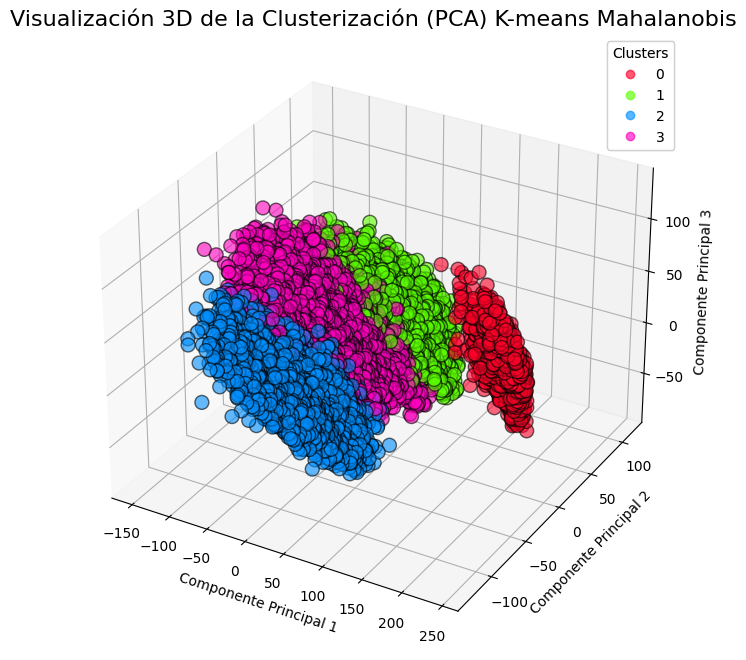

In [ ]:
maha_3D = graficar_clusters_PCA3D(clusters_manuales_maha, 'K-means Mahalanobis')
# Llamar a la función 'graficar_clusters_PCA3D' para visualizar los clusters obtenidos
# mediante el método K-means utilizando la distancia de Mahalanobis en un espacio tridimensional.
# Esto permite observar la separación y distribución de los clusters en tres dimensiones.
maha_3D